In [3]:
import itertools
import operator
import pickle
import re
from abc import *
from copy import deepcopy
from operator import itemgetter
from typing import *
import numpy as np
import scipy as sp
import networkx as nx
import mne
import time
from sklearn import svm
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.neighbors._dist_metrics import DistanceMetric
from sklearn.utils import shuffle
from typing import List, Tuple
from sklearn.model_selection import train_test_split

from nodestimation.learning.connectoming import make_connectome
from nodestimation.learning.estimation import collect_statistic, \
    compute_importance, collect_cross_statistic, make_selection_map, \
    select, separate_datasets, selected_statistic, choose_best, selected_data, make_feature_selection
from nodestimation.learning.informativeness import CrossInformativeness, Informativeness, SubjectsInformativeness, \
    NodesInformativeness
from nodestimation.learning.networking import sparse_graph, graph_to_hemispheres, hemispheres_division_modularity, \
    metric_for_hemispheres
from nodestimation.processing.features import prepare_features
from nodestimation.project import find_subject_dir, conditions_unique_code
from nodestimation.pipeline import pipeline
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
import nibabel
import nilearn.plotting as nplt
from nodestimation.project.actions import read
import nodestimation as nd
from nodestimation.learning.modification import append_series, promote
import nodestimation.learning.modification as lmd
from nodestimation.project.subject import Subject
from sklearn.preprocessing import *
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis, QuadraticDiscriminantAnalysis
from sklearn.feature_selection import SelectFromModel
from sklearn.cluster import KMeans
from sklearn.neural_network import MLPClassifier
import matplotlib as mpl
from nodestimation.learning.selection import SubjectsStatistic, Wilcoxon, Mannwhitneyu, Test
from scipy.stats import wilcoxon
from sklearn.ensemble import VotingClassifier
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import SGDClassifier
from scipy.fftpack import fftfreq, irfft, rfft
from scipy.fftpack import fftfreq, irfft, rfft

ENGEL1 = [
    'B1C2',
    'B1R1',
    'G1R1',
    'G1V2',
    'J1T2',
    'K1V1',
    'L1P1',
    'M1G2',
    'M1N2',
    'O1O2',
    'R1D2',
    'S1A2',
    'S1B1',
    'S1H1',
    'S1U3'
]
ENGEL2 = [
    'L2M1',
    'M2S2',
    'N2K2',
    'P1H2'
]
ENGEL3 = [
    'N3S2',
    'S3R1'
]
ENGEL4 = [
    'K4L2'
]
REJECTED = [
    'S1U3',
    'P1H2'
]

AGE = {
    'B1C2': 28.0,
    'B1R1': 16.0,
    'G1R1': 23.0,
    'G1V2': 5.0,
    'J1T2': 8.0,
    'K1V1': 10.0,
    'K4L2': 14.0,
    'L1P1': 16.0,
    'L2M1': 20.0,
    'M1G2': 8.0,
    'M1N2': 7.0,
    'M2S2': 18.0,
    'N2K2': 30.0,
    'N3S2': 10.0,
    'O1O2': 18.0,
    'R1D2': 6.5,
    'P1H2': 7.0,
    'S1A2': 12.0,
    'S1B1': 17.0,
    'S1H1': 28.0,
    'S3R1': 19.0,
    'S1U3': 15.0,
}

SEX = {
    'B1C2': 'f',
    'B1R1': 'm',
    'G1R1': 'f',
    'G1V2': 'm',
    'J1T2': 'f',
    'K1V1': 'f',
    'K4L2': 'f',
    'L1P1': 'f',
    'L2M1': 'f',
    'M1G2': 'm',
    'M1N2': 'm',
    'M2S2': 'm',
    'N2K2': 'm',
    'N3S2': 'm',
    'O1O2': 'f',
    'R1D2': 'f',
    'P1H2': 'm',
    'S1A2': 'm',
    'S1B1': 'm',
    'S1H1': 'm',
    'S3R1': 'm',
    'S1U3': 'f',
}

SUBJECTS_OLD = pipeline(
    methods=['wpli', 'envelope', 'coh', 'imcoh', 'plv', 'ciplv', 'ppc', 'pli', 'pli2_unbiased', 'wpli2_debiased'],
    freq_bands=(4, 8),
    centrality_metrics=['eigen', 'between', 'degree', 'info']
    )

SUBJECTS_NEW = pipeline(
    methods=['wpli', 'envelope', 'coh', 'imcoh', 'plv', 'ciplv', 'ppc', 'pli', 'pli2_unbiased', 'wpli2_debiased'],
    freq_bands=[(4, 8), (8, 14), (6, 8), (8, 10)],
)

/home/user/.local/lib/python3.9/site-packages/nilearn/datasets/__init__.py:86: FutureWarning: Fetchers from the nilearn.datasets module will be updated in version 0.9 to return python strings instead of bytes and Pandas dataframes instead of Numpy arrays.
  warn("Fetchers from the nilearn.datasets module will be "


All computation has been already done, loading of the existing file with the solution...
All computation has been already done, loading of the existing file with the solution...


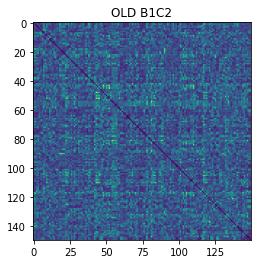

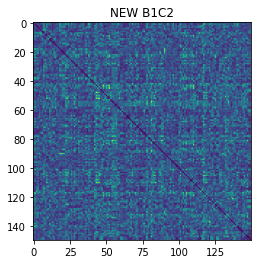

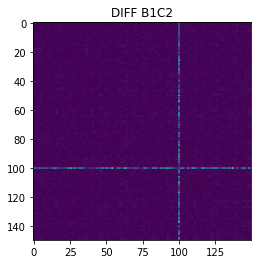

AVERAGE OLD: 0.18994561956675415
AVERAGE NEW: 0.1899298609485426
MAX DIFF: 0.03503



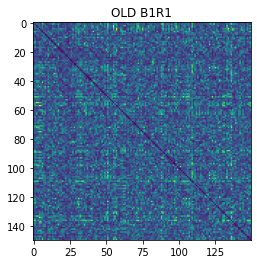

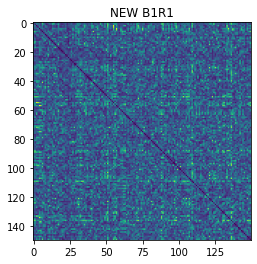

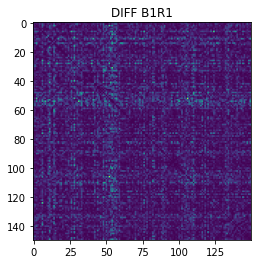

AVERAGE OLD: 0.2025638811781328
AVERAGE NEW: 0.20256387708726806
MAX DIFF: 0.0



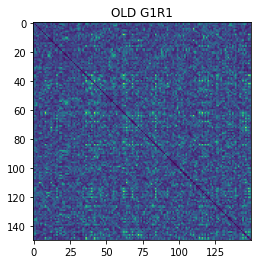

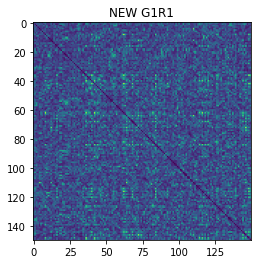

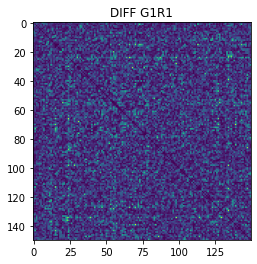

AVERAGE OLD: 0.1867228582580261
AVERAGE NEW: 0.18672285758193535
MAX DIFF: 0.0



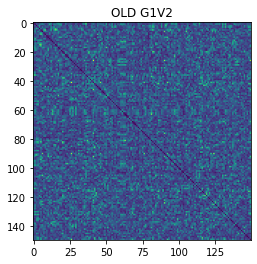

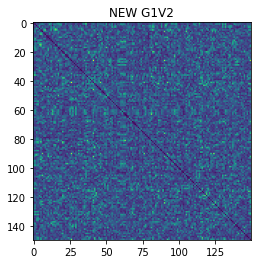

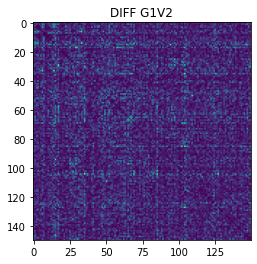

AVERAGE OLD: 0.18138137232977034
AVERAGE NEW: 0.1813813719007525
MAX DIFF: 0.0



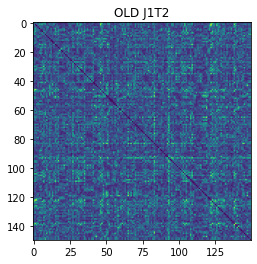

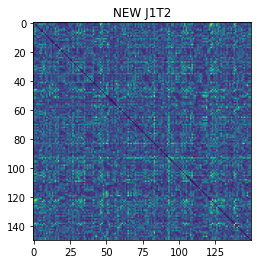

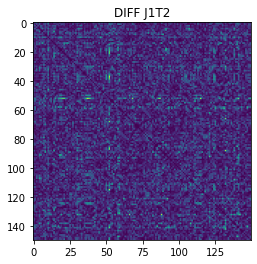

AVERAGE OLD: 0.18598930495180346
AVERAGE NEW: 0.18599549051548928
MAX DIFF: 0.00117



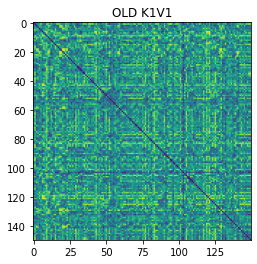

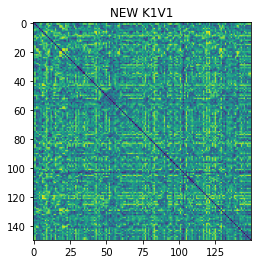

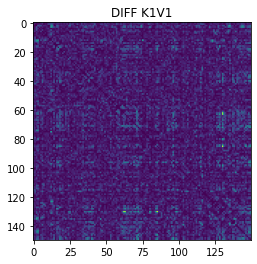

AVERAGE OLD: 0.49081689219697655
AVERAGE NEW: 0.4908181285831185
MAX DIFF: 0.00043



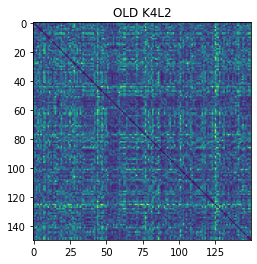

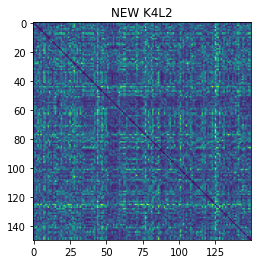

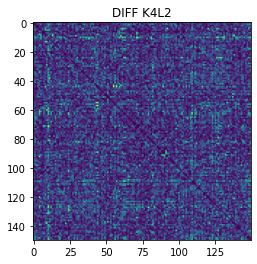

AVERAGE OLD: 0.1722518163694788
AVERAGE NEW: 0.17221659999573574
MAX DIFF: 0.00206



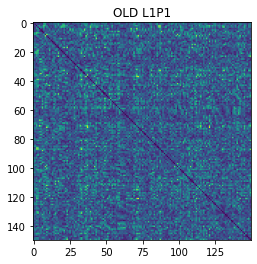

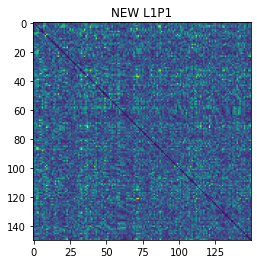

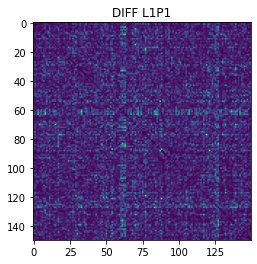

AVERAGE OLD: 0.20660498800659763
AVERAGE NEW: 0.20660499819399797
MAX DIFF: 0.0



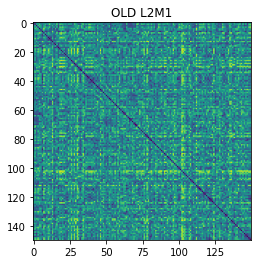

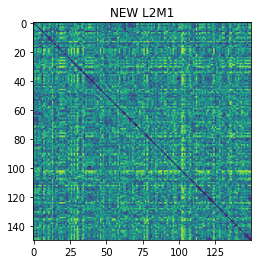

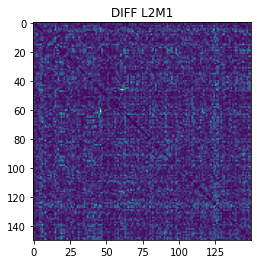

AVERAGE OLD: 0.43881579288708944
AVERAGE NEW: 0.43883108873616644
MAX DIFF: 0.00067



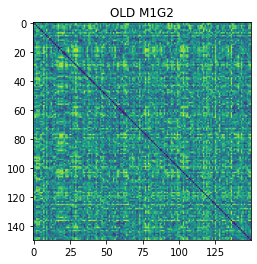

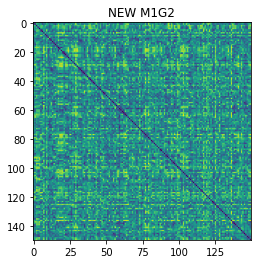

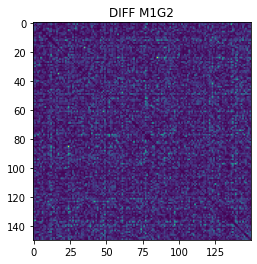

AVERAGE OLD: 0.4749204768678967
AVERAGE NEW: 0.47492845765449204
MAX DIFF: 0.00041



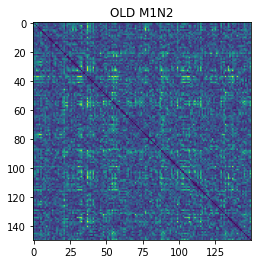

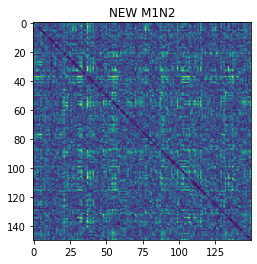

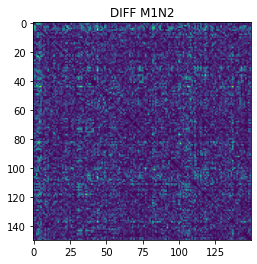

AVERAGE OLD: 0.18876058570785806
AVERAGE NEW: 0.18876057618135292
MAX DIFF: 0.0



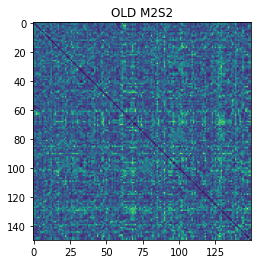

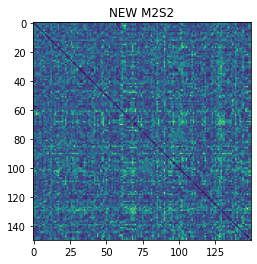

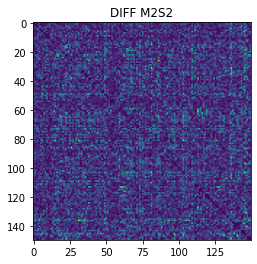

AVERAGE OLD: 0.2086226879141534
AVERAGE NEW: 0.20863233709252493
MAX DIFF: 0.00092



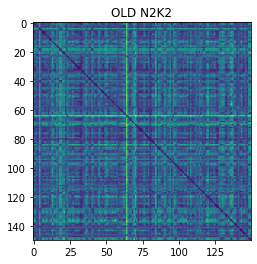

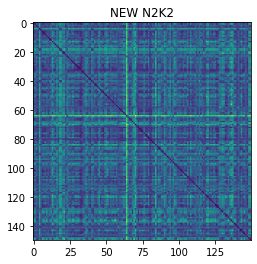

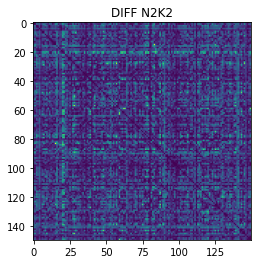

AVERAGE OLD: 0.19119849844789166
AVERAGE NEW: 0.19126073111704747
MAX DIFF: 0.00217



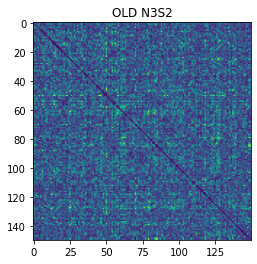

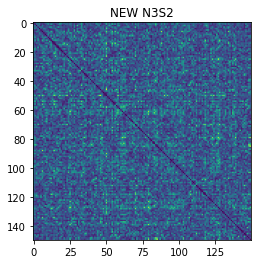

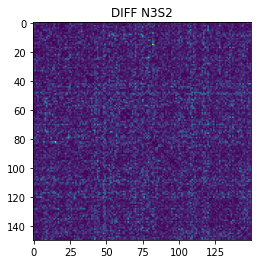

AVERAGE OLD: 0.2037974875601318
AVERAGE NEW: 0.20379748728260527
MAX DIFF: 0.0



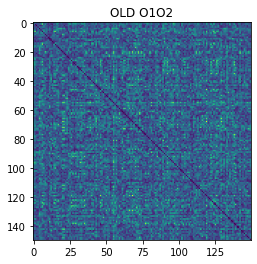

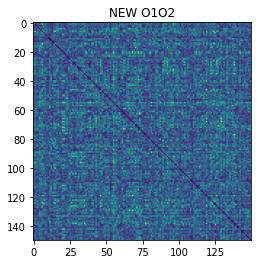

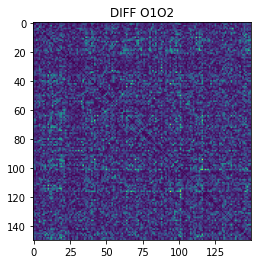

AVERAGE OLD: 0.20347749111713162
AVERAGE NEW: 0.20345792693038764
MAX DIFF: 0.00193



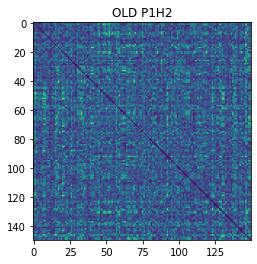

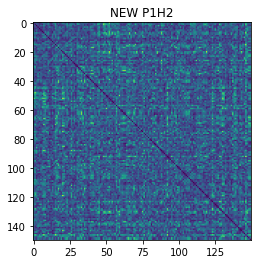

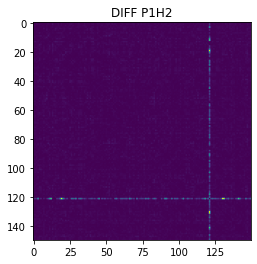

AVERAGE OLD: 0.19236882201612637
AVERAGE NEW: 0.1924793817636727
MAX DIFF: 0.04134



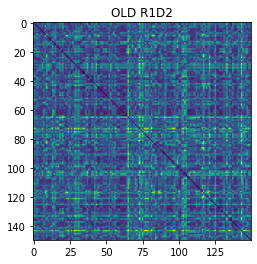

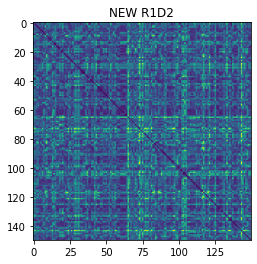

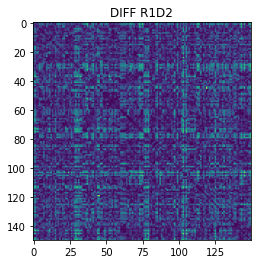

AVERAGE OLD: 0.1731970858518044
AVERAGE NEW: 0.17319580414651703
MAX DIFF: 2e-05



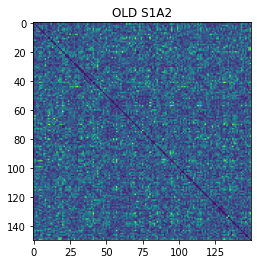

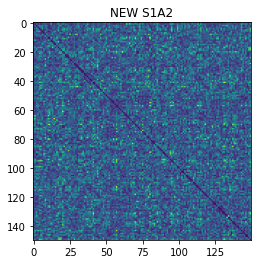

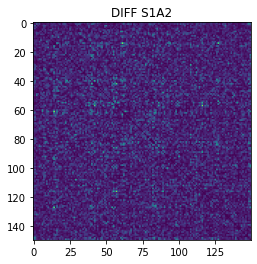

AVERAGE OLD: 0.1817536867350727
AVERAGE NEW: 0.18175368598478314
MAX DIFF: 0.0



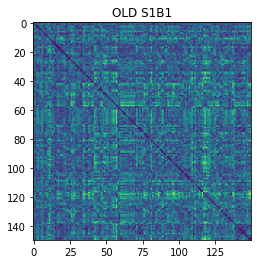

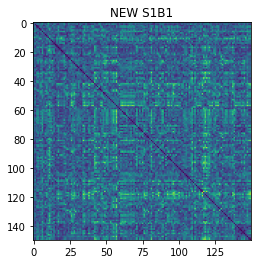

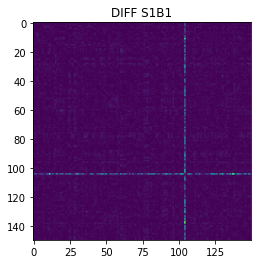

AVERAGE OLD: 0.2757580956039206
AVERAGE NEW: 0.2756481444804641
MAX DIFF: 0.02816



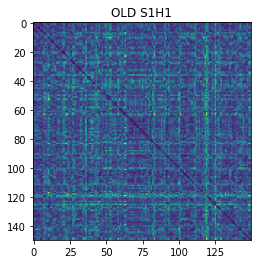

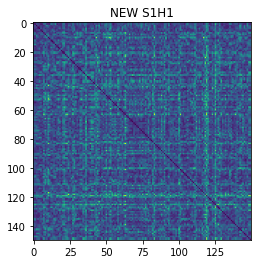

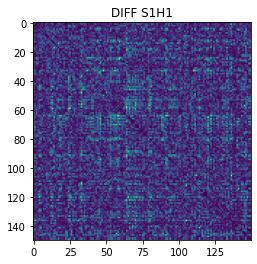

AVERAGE OLD: 0.19943338462488347
AVERAGE NEW: 0.19942283698081578
MAX DIFF: 0.00086



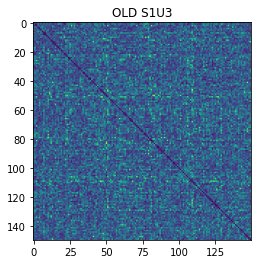

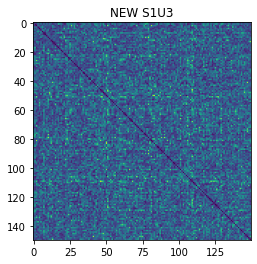

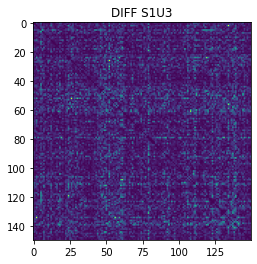

AVERAGE OLD: 0.18920241823264627
AVERAGE NEW: 0.18920241475254646
MAX DIFF: 0.0



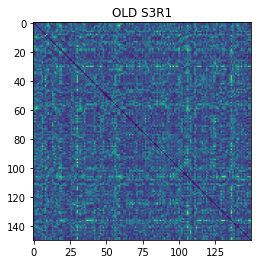

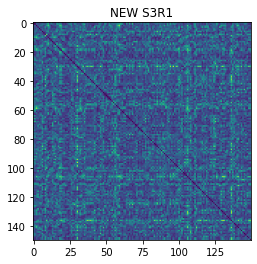

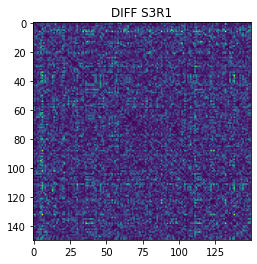

AVERAGE OLD: 0.22039567496609253
AVERAGE NEW: 0.220359489730159
MAX DIFF: 0.00071



In [18]:
subjects_old = sorted(SUBJECTS_OLD.copy(), key=lambda item: item.name)
subjects_new = sorted(SUBJECTS_NEW.copy(), key=lambda item: item.name)

for subject_old, subject_new in zip(subjects_old, subjects_new):
    plt.imshow(subject_old.connectomes['4-8Hz']['wpli'].to_numpy())
    plt.title(f'OLD {subject_old.name}')
    plt.show()
    plt.imshow(subject_new.connectomes['4-8Hz']['wpli'].to_numpy())
    plt.title(f'NEW {subject_new.name}')
    plt.show()
    diff = np.abs(subject_new.connectomes['4-8Hz']['wpli'].to_numpy() - subject_old.connectomes['4-8Hz']['wpli'].to_numpy())
    plt.imshow(diff)
    plt.title(f'DIFF {subject_new.name}')
    plt.show()
    print(
        f'AVERAGE OLD: {subject_old.connectomes["4-8Hz"]["wpli"].mean().mean()}\n'
        f'AVERAGE NEW: {subject_new.connectomes["4-8Hz"]["wpli"].mean().mean()}\n'
        f'MAX DIFF: {np.round(np.max(np.max(diff)), 5)}\n'
    )

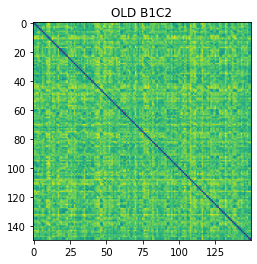

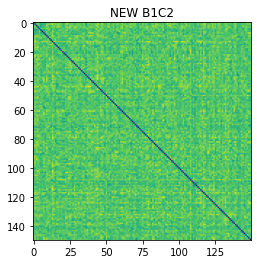

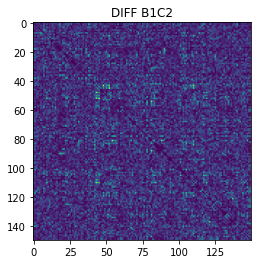

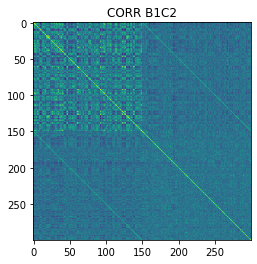

AVERAGE OLD: 0.2676006851595352
AVERAGE NEW: 0.18004659462388228
CORRCOEF: 0.047665225744229274
MEAN DIFF: 0.06895



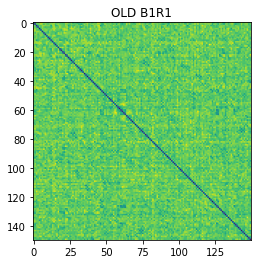

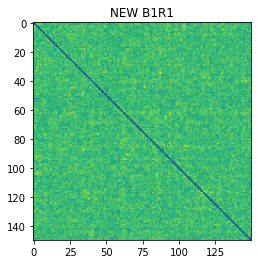

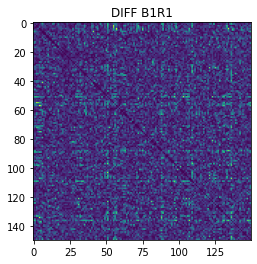

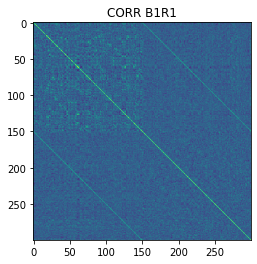

AVERAGE OLD: 0.2829136728003914
AVERAGE NEW: 0.17465797939563743
CORRCOEF: 0.019085134659447132
MEAN DIFF: 0.08009



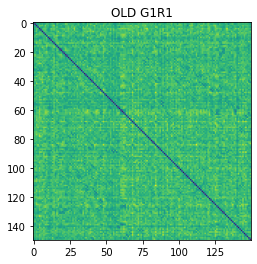

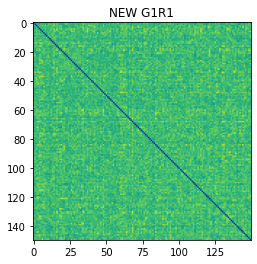

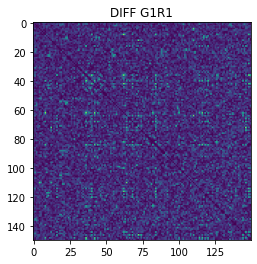

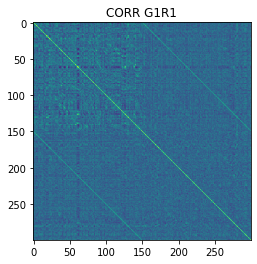

AVERAGE OLD: 0.3031738625994673
AVERAGE NEW: 0.18352185619109884
CORRCOEF: 0.04455424426236806
MEAN DIFF: 0.0745



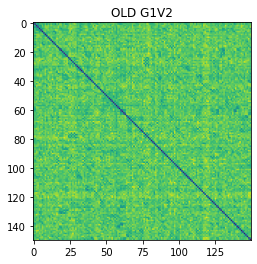

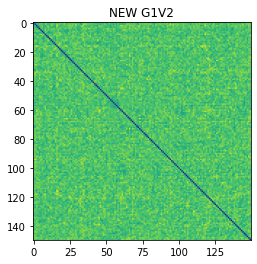

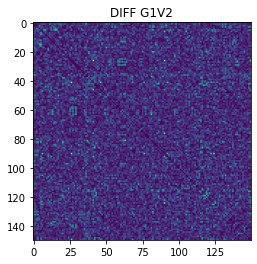

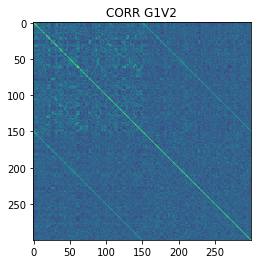

AVERAGE OLD: 0.2809379588122129
AVERAGE NEW: 0.17350940524185934
CORRCOEF: 0.021841917798149195
MEAN DIFF: 0.07149



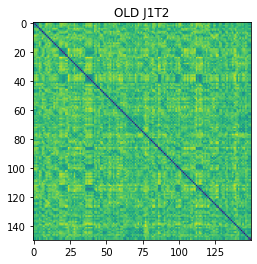

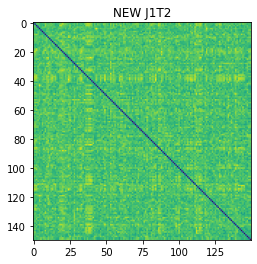

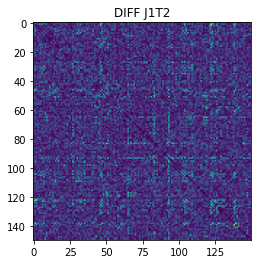

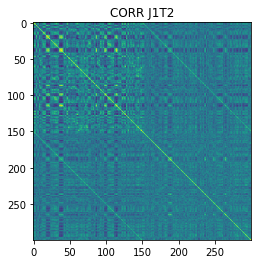

AVERAGE OLD: 0.27198000404590167
AVERAGE NEW: 0.1804152999510741
CORRCOEF: 0.04123744781349069
MEAN DIFF: 0.07448



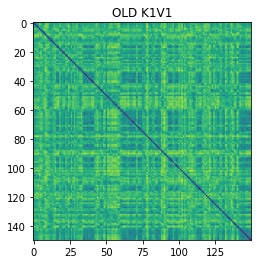

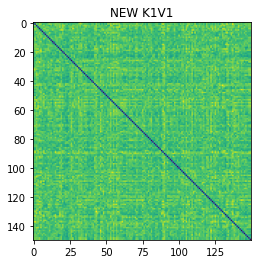

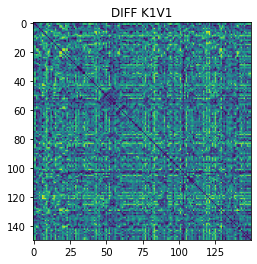

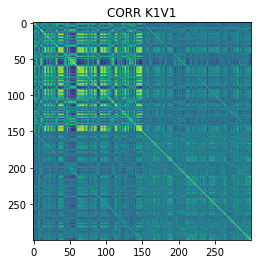

AVERAGE OLD: 0.24879873242819883
AVERAGE NEW: 0.17909363539981688
CORRCOEF: 0.06997512390596307
MEAN DIFF: 0.31308



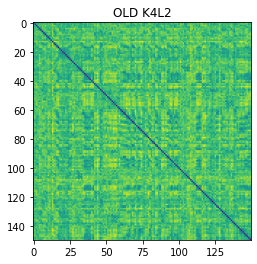

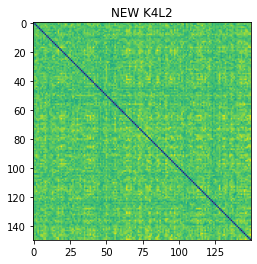

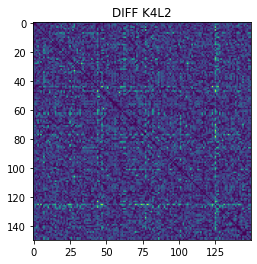

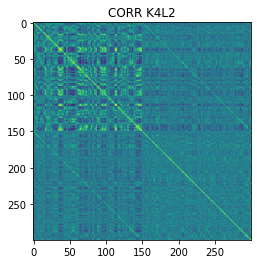

AVERAGE OLD: 0.2701578567740705
AVERAGE NEW: 0.1787703680584954
CORRCOEF: 0.046706013636955375
MEAN DIFF: 0.07022



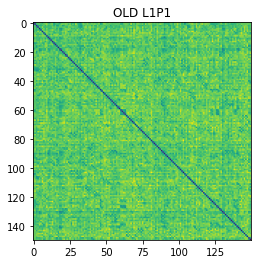

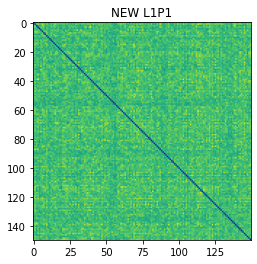

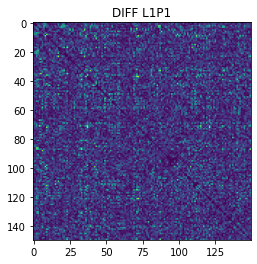

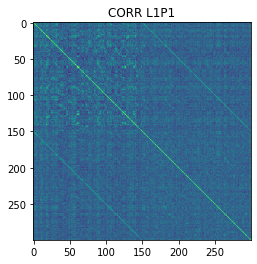

AVERAGE OLD: 0.29752385246591
AVERAGE NEW: 0.18351037212437685
CORRCOEF: 0.04968218464235991
MEAN DIFF: 0.08033



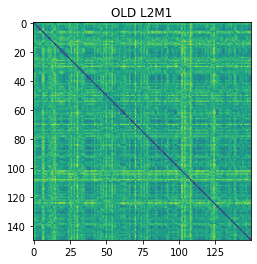

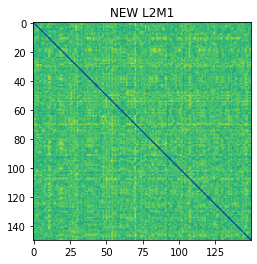

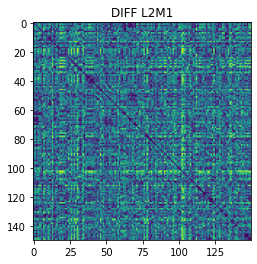

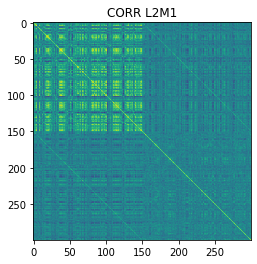

AVERAGE OLD: 0.24373236917250216
AVERAGE NEW: 0.17445425812219692
CORRCOEF: 0.0939181047513761
MEAN DIFF: 0.26661



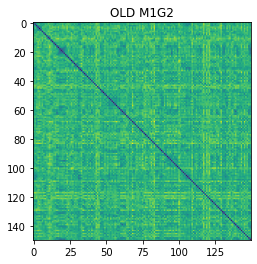

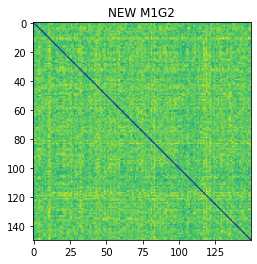

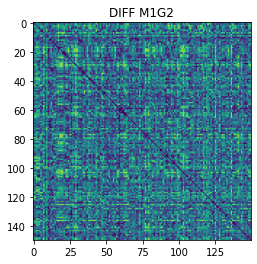

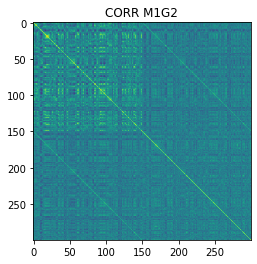

AVERAGE OLD: 0.26249718583308473
AVERAGE NEW: 0.1841767838521798
CORRCOEF: 0.0573093837202345
MEAN DIFF: 0.2925



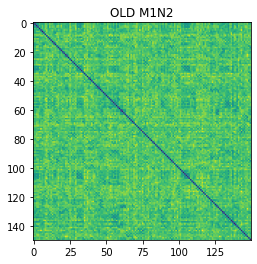

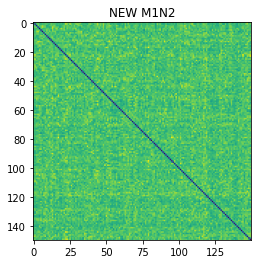

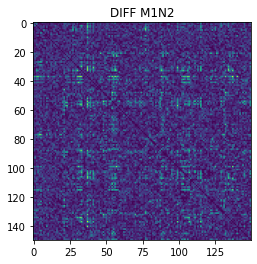

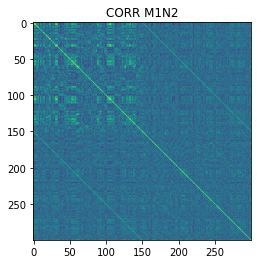

AVERAGE OLD: 0.2835892805248126
AVERAGE NEW: 0.17662127453665563
CORRCOEF: 0.03512373255131187
MEAN DIFF: 0.07539



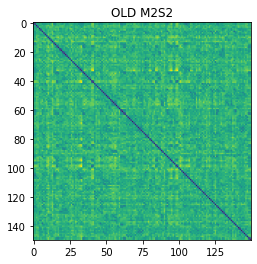

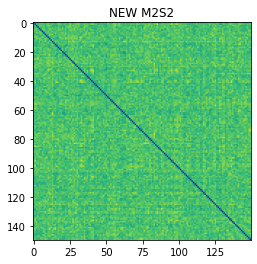

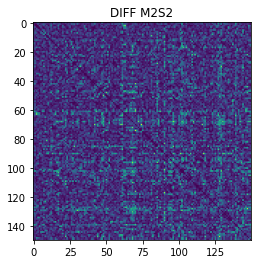

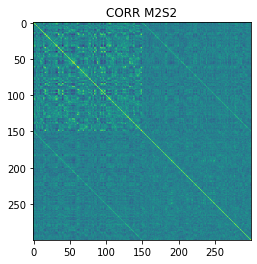

AVERAGE OLD: 0.26295641201477815
AVERAGE NEW: 0.1714092425250123
CORRCOEF: 0.04021050269051053
MEAN DIFF: 0.07938



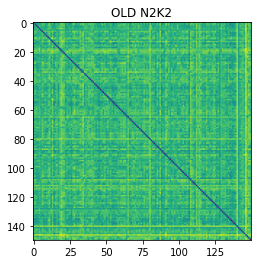

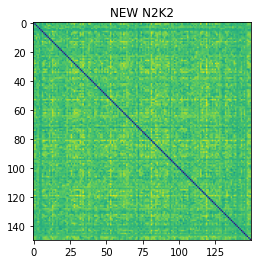

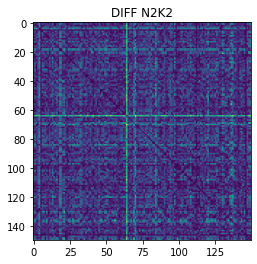

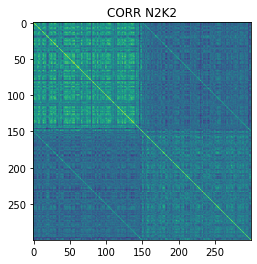

AVERAGE OLD: 0.1907024066388966
AVERAGE NEW: 0.178305196977952
CORRCOEF: 0.08848964668474019
MEAN DIFF: 0.06746



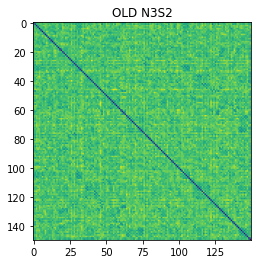

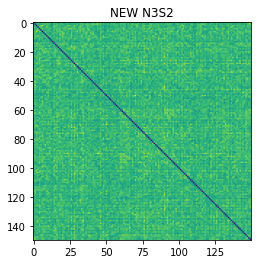

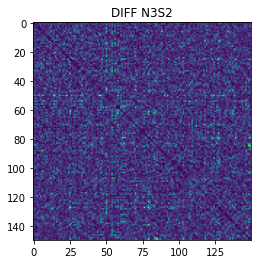

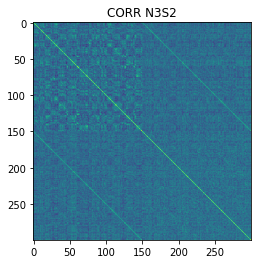

AVERAGE OLD: 0.30370049513972186
AVERAGE NEW: 0.19219858440037677
CORRCOEF: 0.048710082251120175
MEAN DIFF: 0.08005



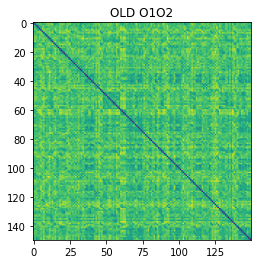

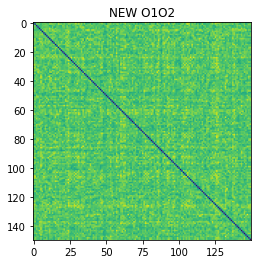

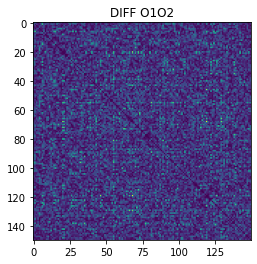

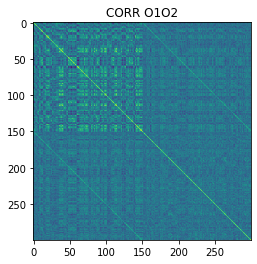

AVERAGE OLD: 0.2747433265888272
AVERAGE NEW: 0.18292910653515784
CORRCOEF: 0.06411182690513406
MEAN DIFF: 0.07536



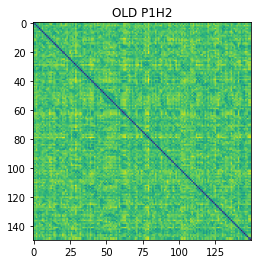

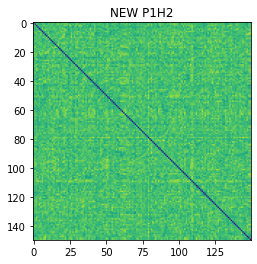

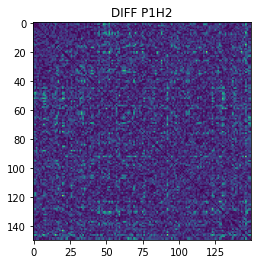

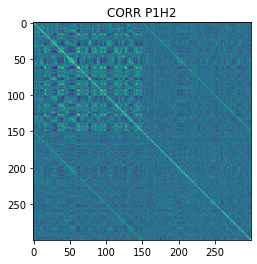

AVERAGE OLD: 0.27412037906225206
AVERAGE NEW: 0.17740724184691065
CORRCOEF: 0.04116454694257971
MEAN DIFF: 0.07422



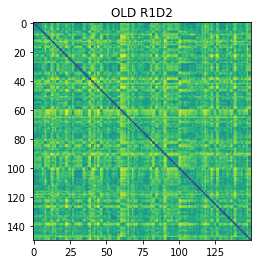

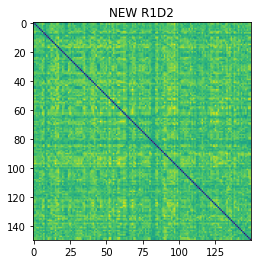

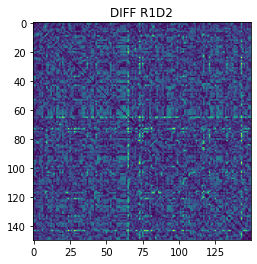

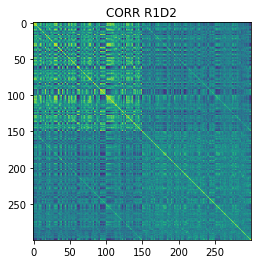

AVERAGE OLD: 0.24667705857361577
AVERAGE NEW: 0.19294554091835187
CORRCOEF: 0.08703593772258945
MEAN DIFF: 0.07793



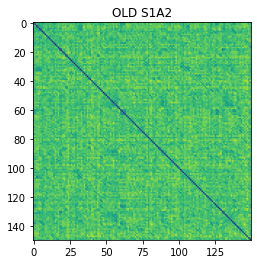

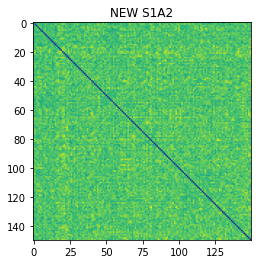

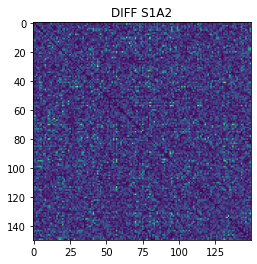

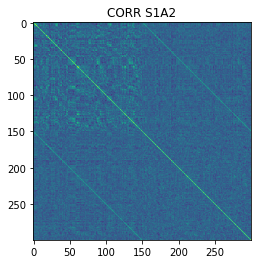

AVERAGE OLD: 0.2888307831788064
AVERAGE NEW: 0.17725570544757388
CORRCOEF: 0.03274416746327536
MEAN DIFF: 0.0707



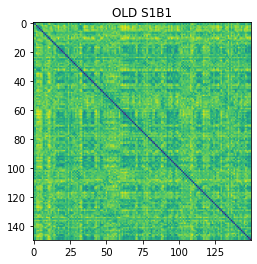

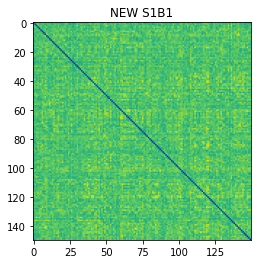

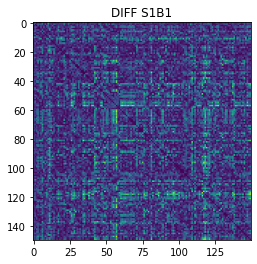

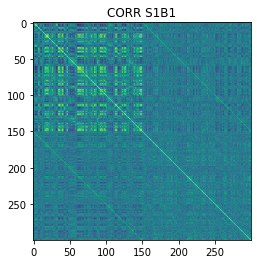

AVERAGE OLD: 0.27400290847164444
AVERAGE NEW: 0.18480777871328144
CORRCOEF: 0.05130954928925488
MEAN DIFF: 0.11352



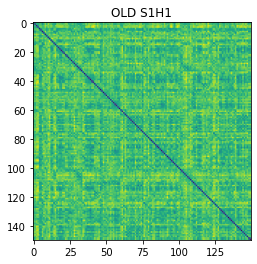

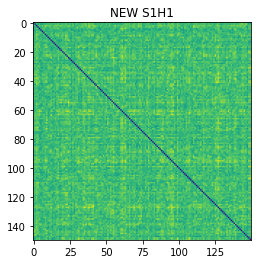

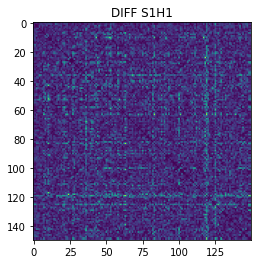

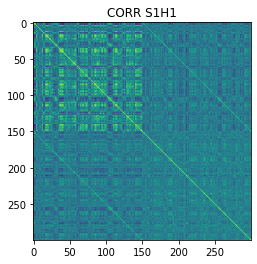

AVERAGE OLD: 0.24909227760718816
AVERAGE NEW: 0.1814894166896076
CORRCOEF: 0.0629500552312366
MEAN DIFF: 0.07738



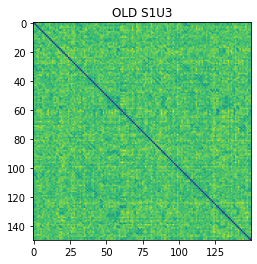

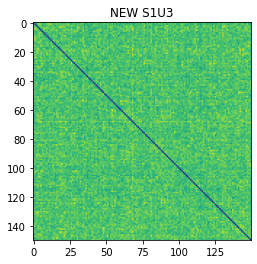

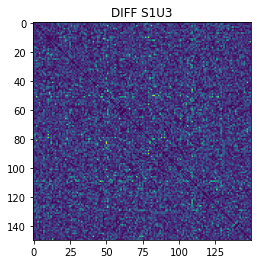

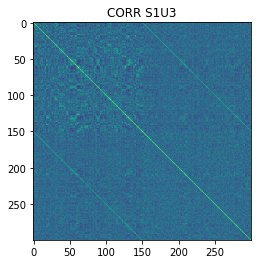

AVERAGE OLD: 0.29877853693876766
AVERAGE NEW: 0.18128770296705313
CORRCOEF: 0.025501398830760354
MEAN DIFF: 0.07231



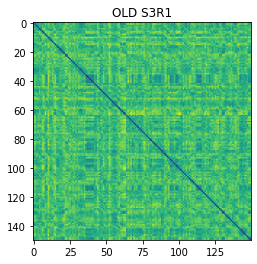

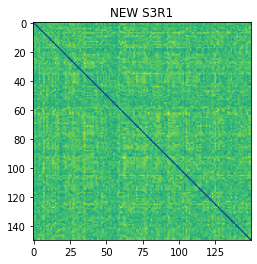

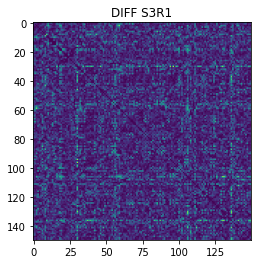

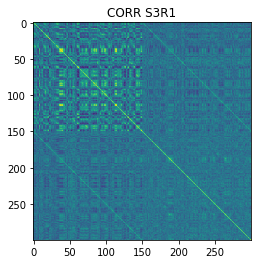

AVERAGE OLD: 0.27071704384470524
AVERAGE NEW: 0.17923699811396213
CORRCOEF: 0.04833648342347181
MEAN DIFF: 0.08295



In [22]:
subjects_old = sorted(SUBJECTS_OLD.copy(), key=lambda item: item.name)
subjects_new = sorted(SUBJECTS_NEW.copy(), key=lambda item: item.name)

for subject_old, subject_new in zip(subjects_old, subjects_new):
    plt.imshow(subject_old.connectomes['4-8Hz']['envelope'].to_numpy())
    plt.title(f'OLD {subject_old.name}')
    plt.show()
    plt.imshow(subject_new.connectomes['4-8Hz']['envelope'].to_numpy())
    plt.title(f'NEW {subject_new.name}')
    plt.show()
    diff = np.abs(subject_new.connectomes['4-8Hz']['envelope'].to_numpy() - subject_old.connectomes['4-8Hz']['wpli'].to_numpy())
    plt.imshow(diff)
    plt.title(f'DIFF {subject_new.name}')
    plt.show()
    corr = np.corrcoef(subject_old.connectomes["4-8Hz"]["envelope"], subject_new.connectomes["4-8Hz"]["envelope"])
    plt.imshow(corr)
    plt.title(f'CORR {subject_new.name}')
    plt.show()
    print(
        f'AVERAGE OLD: {subject_old.connectomes["4-8Hz"]["envelope"].mean().mean()}\n'
        f'AVERAGE NEW: {subject_new.connectomes["4-8Hz"]["envelope"].mean().mean()}\n'
        f'CORRCOEF: {corr.mean().mean()}\n'
        f'MEAN DIFF: {np.round(np.mean(np.mean(diff)), 5)}\n'
    )